# ARU - Hackathon - EDA

In [1]:
%%time

# load libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import itertools
import plotly.graph_objects as go
from plotly.subplots import make_subplots


pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import warnings  # For handling warnings
warnings.filterwarnings('ignore')  # Ignore all warnings

print("Done!")

Done!
Wall time: 5.34 s


In [2]:
def find_column_row_number(number_of_values):
  col_num = number_of_values
  rows = np.floor(np.sqrt(col_num))
  while(col_num % rows != 0):
       rows = rows - 1
  if col_num/rows > 5:
    cols = 5
    rows = int(np.ceil(col_num/cols))
  else:
    cols = int(rows)
    rows = int(col_num/rows)
  if cols > rows:
    cols, rows = rows, cols
  return cols, rows

def plot_distribution(df, columns, plot):
  
  col_num = len(columns)
  cols, rows = find_column_row_number(col_num)
  
  combinations = list(itertools.product(range(1, rows+1), range(1, cols+1)))[:col_num]
  combinations_dict = {columns[i]: combinations[i] for i in range(col_num)}

  fig = make_subplots(rows=rows, cols=cols, subplot_titles=(columns))
  
  if plot == 'H':

    for c, fig_info  in combinations_dict.items():
      row_num, col_num  = fig_info

      fig.add_trace(go.Histogram(x=df[c], name = c,  opacity=0.7), row= row_num, col= col_num)
  
  if plot == 'B':

    for c, fig_info  in combinations_dict.items():
      row_num, col_num  = fig_info

      fig.add_trace(go.Box(x=df[c], name = c,  opacity=0.7), row= row_num, col= col_num)
      fig.update_yaxes(showticklabels=False)
      
  if plot == 'V':

    for c, fig_info  in combinations_dict.items():
      row_num, col_num  = fig_info

      fig.add_trace(go.Violin(x=df[c], name = c, box_visible=True, meanline_visible=True,  opacity=0.7), row= row_num, col= col_num)
      fig.update_yaxes(showticklabels=False)
      
  fig.update_layout(showlegend = False,
      autosize=False,
      width=1600,
      height=1200,
      template = 'plotly_white')

  fig.show(renderer="vscode")

def colinearity(df):

  corr = df.corr()

  # Generate a mask for the upper triangle
  mask = np.triu(np.ones_like(corr, dtype=bool))

  # Set up the matplotlib figure
  f, ax = plt.subplots(figsize=(11, 9))

  # Generate a custom diverging colormap

  # Draw the heatmap with the mask and correct aspect ratio
  sns.heatmap(corr, annot=True,
            annot_kws={"fontsize": 12},
            linewidths=0.5,
            center=0.00,
            fmt=".2f",
            xticklabels= corr.columns,
            yticklabels= corr.columns,
            ax=ax,
            mask=mask,
            cmap = sns.diverging_palette(10, 240, n=9),
            vmin=-1, 
            vmax=1)

In [3]:
# locate data
import os
os.listdir('../aru-hackathon-team1')

['.git',
 '.ipynb_checkpoints',
 'coding_space.ipynb',
 'corona_tested_individuals_ver_006.english.csv',
 'EDA.ipynb',
 'ML_modelling.ipynb',
 'README.md']

In [4]:
# load data
df = pd.read_csv("corona_tested_individuals_ver_006.english.csv")
print(df.shape)
df.head(5)

(278848, 10)


,test_date,cough,fever,sore_throat,shortness_of_breath,head_ache,corona_result,age_60_and_above,gender,test_indication
0,2020-04-30,0,0,0,0,0,negative,None,female,Other
1,2020-04-30,1,0,0,0,0,negative,None,female,Other
2,2020-04-30,0,1,0,0,0,negative,None,male,Other
3,2020-04-30,1,0,0,0,0,negative,None,female,Other
4,2020-04-30,1,0,0,0,0,negative,None,male,Other


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278848 entries, 0 to 278847
Data columns (total 10 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   test_date            278848 non-null  object
 1   cough                278848 non-null  object
 2   fever                278848 non-null  object
 3   sore_throat          278848 non-null  object
 4   shortness_of_breath  278848 non-null  object
 5   head_ache            278848 non-null  object
 6   corona_result        278848 non-null  object
 7   age_60_and_above     278848 non-null  object
 8   gender               278848 non-null  object
 9   test_indication      278848 non-null  object
dtypes: object(10)
memory usage: 21.3+ MB


In [6]:
df.describe()


,test_date,cough,fever,sore_throat,shortness_of_breath,head_ache,corona_result,age_60_and_above,gender,test_indication
count,278848,278848,278848,278848,278848,278848,278848,278848,278848,278848
unique,51,5,5,5,5,5,3,3,3,3
top,2020-04-20,0,0,0,0,0,negative,None,female,Other
freq,10921,121649,133942,260664,261079,260079,260227,127320,130158,242741


In [7]:
df.isna().sum()/len(df)*100

test_date              0.0
cough                  0.0
fever                  0.0
sore_throat            0.0
shortness_of_breath    0.0
head_ache              0.0
corona_result          0.0
age_60_and_above       0.0
gender                 0.0
test_indication        0.0
dtype: float64

In [8]:
df.value_counts('corona_result')

corona_result
negative    260227
positive     14729
other         3892
dtype: int64

In [9]:
df.value_counts('age_60_and_above')

age_60_and_above
None    127320
No      125703
Yes      25825
dtype: int64

In [10]:
df.value_counts('gender')

gender
female    130158
male      129127
None       19563
dtype: int64

In [11]:
df.value_counts('test_indication')

test_indication
Other                     242741
Abroad                     25468
Contact with confirmed     10639
dtype: int64

In [12]:
df.columns

Index(['test_date', 'cough', 'fever', 'sore_throat', 'shortness_of_breath',
       'head_ache', 'corona_result', 'age_60_and_above', 'gender',
       'test_indication'],
      dtype='object')

In [13]:
df.dropna(inplace=True, subset=['cough', 'fever', 'sore_throat', 'shortness_of_breath','head_ache'])

In [14]:
df = df.fillna('NaN')

In [15]:
df = df.loc[(df['corona_result'] == 'positive') | (df['corona_result'] == 'negative')]

In [16]:
binary_df = df[['corona_result']]

In [17]:
binary_df = pd.get_dummies(binary_df, drop_first=True)

In [18]:
binary_df = binary_df.replace({True:1,False:0})

In [19]:
binary_df.columns = ['is_corona_positive']

In [20]:
display(binary_df.head(5))

,is_corona_positive
0,0
1,0
2,0
3,0
4,0


In [21]:
cat_df = df[['test_indication','age_60_and_above','gender']]

In [22]:
cat_df = pd.get_dummies(cat_df)

In [23]:
cat_df = cat_df.replace({True:1,False:0})

In [24]:
display(cat_df.head(5))

,test_indication_Abroad,test_indication_Contact with confirmed,test_indication_Other,age_60_and_above_No,age_60_and_above_None,age_60_and_above_Yes,gender_None,gender_female,gender_male
0,0,0,1,0,1,0,0,1,0
1,0,0,1,0,1,0,0,1,0
2,0,0,1,0,1,0,0,0,1
3,0,0,1,0,1,0,0,1,0
4,0,0,1,0,1,0,0,0,1


In [25]:
num_df = df.select_dtypes(include=['float64'])

In [26]:
from datetime import datetime

df['test_date'] = pd.to_datetime(df['test_date'])

start_date = datetime(2020, 3, 11)

df['days_since_start'] = (df['test_date'] - start_date).dt.days

In [27]:
df2 = pd.concat([binary_df, cat_df], axis=1)
df2 = pd.concat([num_df, df2], axis=1)
df2 = pd.concat([df['days_since_start'], df2], axis=1)

In [28]:
df2 = df2.astype(int)

In [29]:
display(df2.head(5))

,days_since_start,is_corona_positive,test_indication_Abroad,test_indication_Contact with confirmed,test_indication_Other,age_60_and_above_No,age_60_and_above_None,age_60_and_above_Yes,gender_None,gender_female,gender_male
0,50,0,0,0,1,0,1,0,0,1,0
1,50,0,0,0,1,0,1,0,0,1,0
2,50,0,0,0,1,0,1,0,0,0,1
3,50,0,0,0,1,0,1,0,0,1,0
4,50,0,0,0,1,0,1,0,0,0,1


In [30]:
import plotly.io as pio
pio.renderers.default = "vscode"

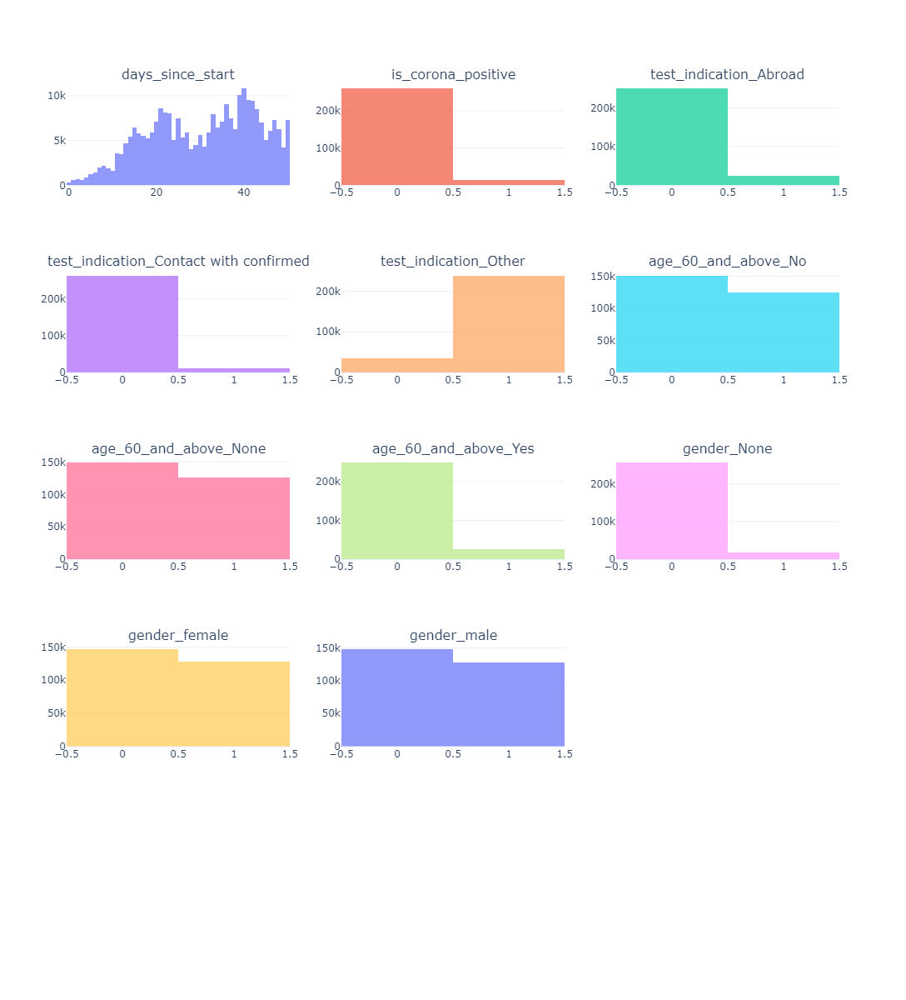

In [31]:
plot_distribution(df2, df2.columns, plot='H')

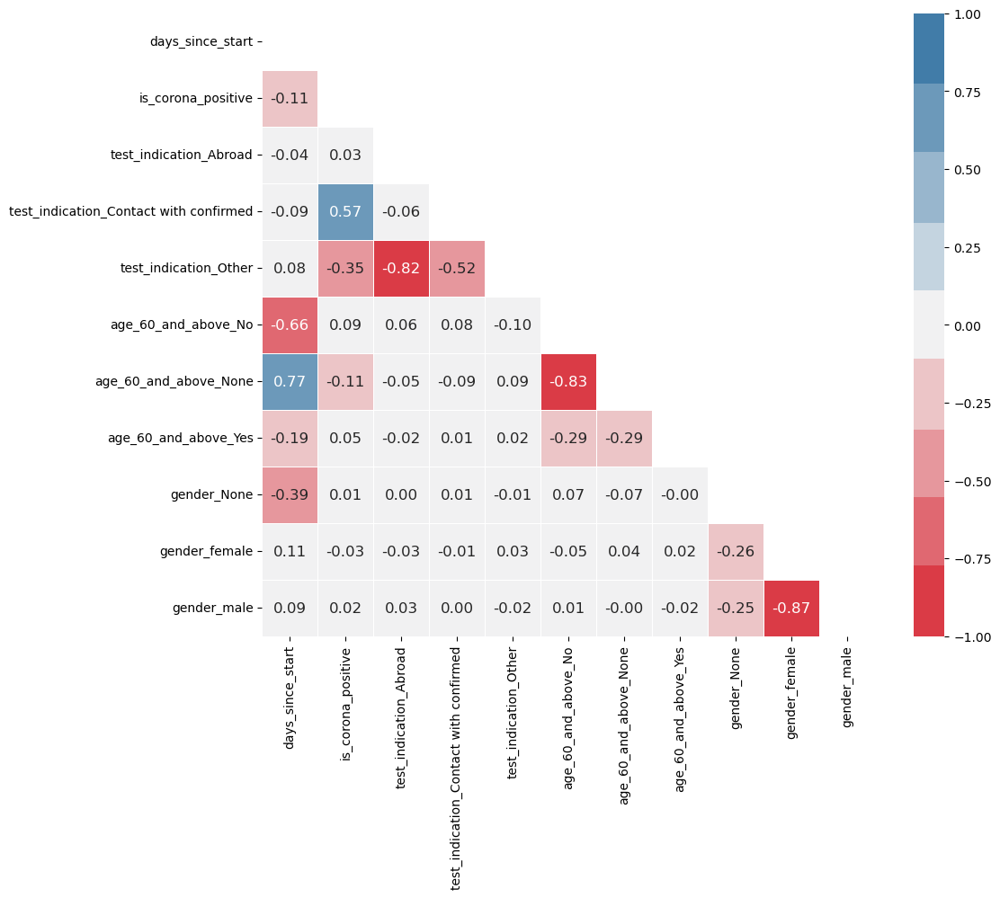

In [32]:
colinearity(df2)

In [33]:
final_df = df2.drop(columns = ['gender_female', 'age_60_and_above_No'])

In [34]:
display(final_df.head(5))

,days_since_start,is_corona_positive,test_indication_Abroad,test_indication_Contact with confirmed,test_indication_Other,age_60_and_above_None,age_60_and_above_Yes,gender_None,gender_male
0,50,0,0,0,1,1,0,0,0
1,50,0,0,0,1,1,0,0,0
2,50,0,0,0,1,1,0,0,1
3,50,0,0,0,1,1,0,0,0
4,50,0,0,0,1,1,0,0,1


### Export final_df as csv

In [35]:
final_df.to_csv('final_df.csv', index=False)